In [1]:
import pandas as pd
import numpy as np 
import math as mt
import s3fs
import zipfile
import os
import matplotlib.pyplot as plt

pd.options.plotting.backend = "plotly"

class s3_connection():
    def __init__(self):
        """
        établir la connexion et après utiliser les fonction de read et write 
        """
        try:
         s3 = s3fs.S3FileSystem(client_kwargs={"endpoint_url": "https://minio.lab.sspcloud.fr"})
         
         print("connection successful")
         
        except:
         s3="connection not established, debug "
         print(s3)
        self.s3=s3
    def listt(self, directory):
        return((self.s3.ls(directory)))

    def unzip(self,from_s,to_s):
      with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
            zip_ref.extractall(extract_to_path)

    
    def from_pandas_to_parquet_store_in_s3(self,df, directory):
      try:
        with self.s3.open(directory, "wb") as file_out:
         df.to_parquet(file_out)
      except: 
        print("Cher lecteur, cette fonction écrit dans le dossier spécifié, mais vous n'avez pas les droits :( ")
      
    
    def get_tables_from_s3(self,directory):
        
        with self.s3.open(directory, "rb") as file_in:
          df = pd.read_parquet(file_in)
        return df
 

In [2]:
  
    
s3=s3_connection()
directory="aayrapetyan/diffusion/"
tables=s3.listt(directory)

dataframes = {}
words_to_remove = ["aayrapetyan", "diffusion", ".us", "--", "usd-spot","parquet"]
import re
# Loop through all files in the folder
for file_name in tables:
    if file_name.endswith('.parquet') and "final_table" not in file_name:  # Check if the file is a Parquet file
        
        try:
            # Read the Parquet file into a DataFrame
            df = s3.get_tables_from_s3(file_name)
            # Store the DataFrame using the file name (without extension) as the key
            pattern = "|".join(re.escape(word) for word in words_to_remove)
            cleaned_string = re.sub(pattern, "", file_name)
            cleaned_string = re.sub(r"[/\.]+", "/", cleaned_string).strip("/")[0:-1]
            dataframes[cleaned_string] = df
            print(f"Loaded {file_name} successfully!")
        except Exception as e:
            print(f"Error loading {file_name}: {e}")

for key in dataframes.keys():
    print(key)

dataframes["ftx-dai"]

connection successful
Loaded aayrapetyan/diffusion/binance.us-dai-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/binance.us-usdc-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/binance.us-usdt-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/coinbase-dai-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/coinbase-usdt-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/coinbase-wluna-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/ftx-cusdt-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/ftx-dai-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/ftx-luna-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/kraken-dai-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/kraken-luna-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/kraken-usdc-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/kraken-usdt-usd-spot.parquet successfully!
binance-dai
binance-usdc
binance-us

,market,time,coin_metrics_id,amount,price,database_time,side
0,ftx-dai-usd-spot,2022-01-01 00:19:59.720191+00:00,2953428441,3028.9,1.0,2022-01-01 00:20:00.075013+00:00,buy
1,ftx-dai-usd-spot,2022-01-01 00:19:59.720191+00:00,2953428442,2000.0,1.0,2022-01-01 00:20:00.075013+00:00,buy
2,ftx-dai-usd-spot,2022-01-01 00:19:59.720191+00:00,2953428443,1.0,1.0,2022-01-01 00:20:00.075013+00:00,buy
3,ftx-dai-usd-spot,2022-01-01 00:19:59.720191+00:00,2953428444,5.0,1.0,2022-01-01 00:20:00.075013+00:00,buy
4,ftx-dai-usd-spot,2022-01-01 00:19:59.720191+00:00,2953428445,2150.2,1.0,2022-01-01 00:20:00.075013+00:00,buy
...,...,...,...,...,...,...,...
126811,ftx-dai-usd-spot,2022-11-12 03:22:06.088667+00:00,5412623105,29.1,1.013,2022-11-12 03:22:06.375870+00:00,sell
126812,ftx-dai-usd-spot,2022-11-12 03:22:06.224272+00:00,5412623109,49.4,1.013,2022-11-12 03:22:06.375870+00:00,sell
126813,ftx-dai-usd-spot,2022-11-12 03:22:06.258189+00:00,5412623113,29.5,1.013,2022-11-12 03:22:06.375870+00:00,sell
126814,ftx-dai-usd-spot,2022-11-12 03:22:06.354345+00:00,5412623119,42.2,1.013,2022-11-12 03:22:06.625909+00:00,sell


In [3]:
def plot_stablecoin_prices(stablecoin, title, dataframes):
    plt.figure(figsize=(30, 6))   
    df = dataframes[stablecoin]
    print(df.columns)
    if f"price_outlier" in df.columns:
        print("ok")
        # Séparer les valeurs normales et les outliers
        normal_values = df[df[f"price_outlier"] == 0]
        outliers = df[df[f"price_outlier"] == 1]

        # Tracer les valeurs normales en bleu
        plt.plot(normal_values['time'], normal_values['price'], color='blue', label='Normal Values')

        # Tracer les outliers en rouge
        plt.scatter(outliers['time'], outliers['price'], color='red', label='Outliers', zorder=3)
    else:
        print("else")
        # Tracer normalement si la colonne outlier n'existe pas
        plt.plot(df['time'], df['price'], color='blue', label='Price')

    plt.xlabel('Time')
    plt.ylabel('Price')
    plt.title(title)
    plt.legend()
    plt.grid(True)
    plt.show()


def mark_outliers(df, columns):
    """
    Mark outliers in the specified columns of a DataFrame.
    Outliers are defined as values that are more than 3 standard deviations away from the mean.
    A new column '{column}_outlier' is added, initialized to 0, and set to 1 if the value is an outlier.
    """
    df = df.copy()  # Pour éviter de modifier l'original directement
    
    for column in columns:
        if column in df.columns:
            # Calcul des bornes
            mean = df[column].mean()
            std = df[column].std()
            lower_bound = mean - 3 * std
            upper_bound = mean + 3 * std

            # Création de la colonne binaire d'outliers
            df[f"{column}_outlier"] = ((df[column] < lower_bound) | (df[column] > upper_bound)).astype(int)

            # Nombre d'outliers détectés
            outlier_count = df[f"{column}_outlier"].sum()
            print(f"{column}: {outlier_count} outliers marked")
    
    return df


In [4]:
# import copy


def aggreg(coin, plateform, type):
    # Vérifier que type est bien dans les valeurs attendues
    if type not in ["day", "hour", "minute"]:
        
        raise ValueError("Type must be 'day', 'hour', or 'minute'")

    # df = copy.deepcopy(dataframes) ## trop long à executer
    
    df = dataframes[f"{plateform}-{coin}"].copy()
    df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")
    dataframes[f"{type}-{plateform}-{coin}"] = df.groupby("time", as_index=False)["price"].mean()

aggreg("dai","binance","hour")
aggreg("dai","binance","day")
aggreg("dai","binance","minute")




/tmp/ipykernel_38864/2598949796.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")
/tmp/ipykernel_38864/2598949796.py:13: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")


In [5]:
dataframes["minute-binance-dai"]


,time,price
0,2022-01-01 00:20:00+00:00,0.9995
1,2022-01-01 01:00:00+00:00,0.9995
2,2022-01-01 01:14:00+00:00,0.9995
3,2022-01-01 01:18:00+00:00,1.0004
4,2022-01-01 01:20:00+00:00,1.0004
...,...,...
11030,2022-12-31 17:16:00+00:00,0.9992
11031,2022-12-31 17:53:00+00:00,0.9995
11032,2022-12-31 21:46:00+00:00,0.9999
11033,2022-12-31 21:48:00+00:00,0.9999


In [83]:

dataframes["mark-hour-binance-dai"] = mark_outliers(dataframes["hour-binance-dai"], ["price"])

dataframes["mark-day-binance-dai"] = mark_outliers(dataframes["day-binance-dai"], ["price"])
# dataframes["mark-coinbase-dai"] = mark_outliers(dataframes["coinbase-dai"], ["price"])

# dataframes["mark-kraken-dai"] = mark_outliers(dataframes["kraken-dai"], ["price"])

# #usdt
# dataframes["new-binance-usdt"] = remove_outliers(dataframes["binance-usdt"], ["price"])
# dataframes["new-coinbase-usdt"] = remove_outliers(dataframes["coinbase-usdt"], ["price"])
# dataframes["new-kraken-usdt"] = remove_outliers(dataframes["kraken-usdt"], ["price"])

# #usdc
# dataframes["new-binance-usdc"] = remove_outliers(dataframes["binance-usdc"], ["price"])
# dataframes["new-kraken-usdc"] = remove_outliers(dataframes["kraken-usdc"], ["price"])
# dataframes["new-binance-usdc"] = remove_outliers(dataframes["new-binance-usdc"], ["price"])

price: 21 outliers marked
price: 3 outliers marked


Index(['time', 'price', 'price_outlier'], dtype='object')
ok


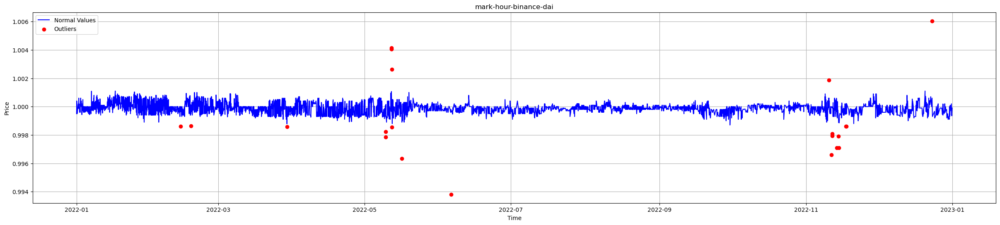

Index(['time', 'price', 'price_outlier'], dtype='object')
ok


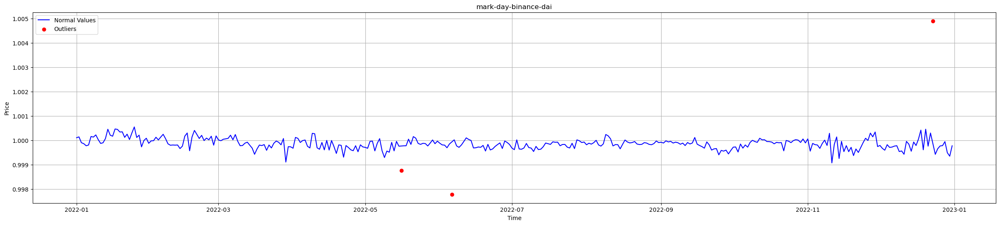

In [84]:
plot_stablecoin_prices("mark-hour-binance-dai", "mark-hour-binance-dai", dataframes)
plot_stablecoin_prices("mark-day-binance-dai", "mark-day-binance-dai", dataframes)


Index(['market', 'time', 'coin_metrics_id', 'amount', 'price', 'database_time',
       'side'],
      dtype='object')
else


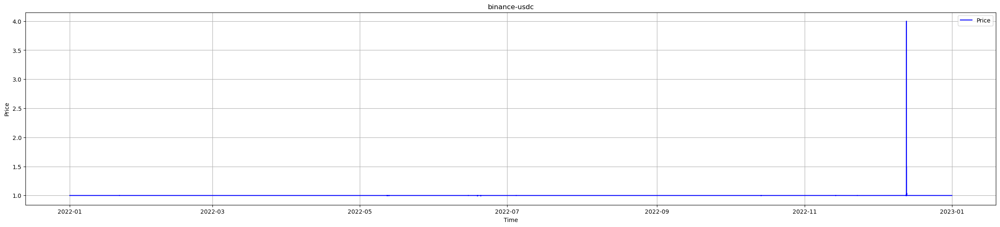

In [8]:
plot_stablecoin_prices("binance-usdc", "binance-usdc", dataframes)

# Dorénavant on va s'interesser au crash du Luna

In [7]:
aggreg("luna","kraken","hour")
aggreg("luna","ftx","hour")
aggreg("wluna","coinbase","hour")

aggreg("luna","kraken","day")
aggreg("luna","ftx","day")
aggreg("wluna","coinbase","day")

aggreg("luna","kraken","minute")
aggreg("luna","ftx","minute")
aggreg("wluna","coinbase","minute")


/tmp/ipykernel_38864/2598949796.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")
/tmp/ipykernel_38864/2598949796.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")
/tmp/ipykernel_38864/2598949796.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")
/tmp/ipykernel_38864/2598949796.py:13: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")
/tmp/ipykernel_38864/2598949796.py:13: FutureWarning: 'T' is deprecated and wi

Index(['time', 'price'], dtype='object')
else


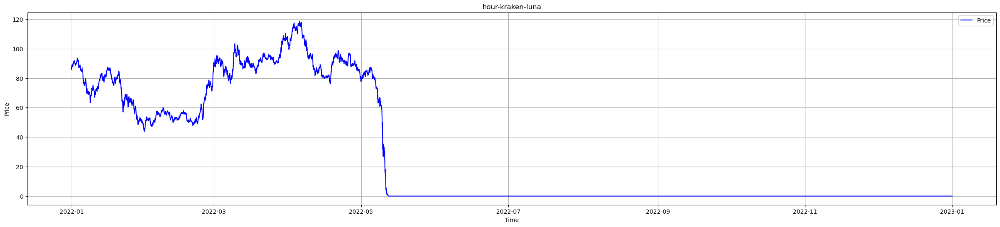

Index(['time', 'price'], dtype='object')
else


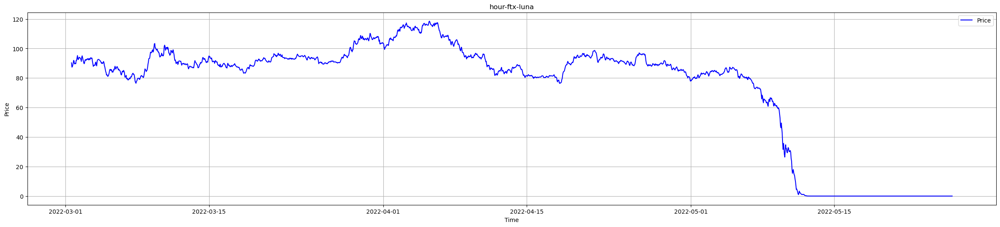

Index(['time', 'price'], dtype='object')
else


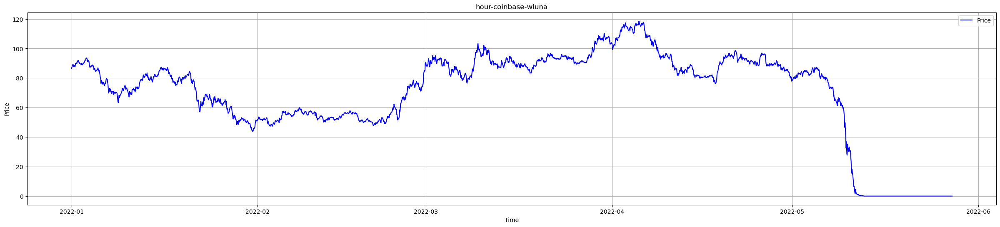

In [70]:
plot_stablecoin_prices("hour-kraken-luna", "hour-kraken-luna", dataframes)
plot_stablecoin_prices("hour-ftx-luna", "hour-ftx-luna", dataframes)
plot_stablecoin_prices("hour-coinbase-wluna", "hour-coinbase-wluna", dataframes)

Index(['time', 'price'], dtype='object')
else


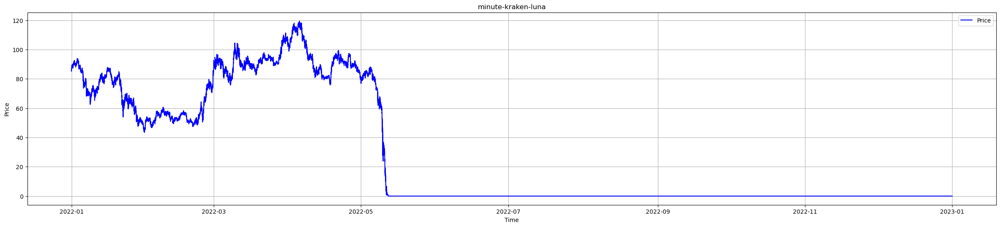

Index(['time', 'price'], dtype='object')
else


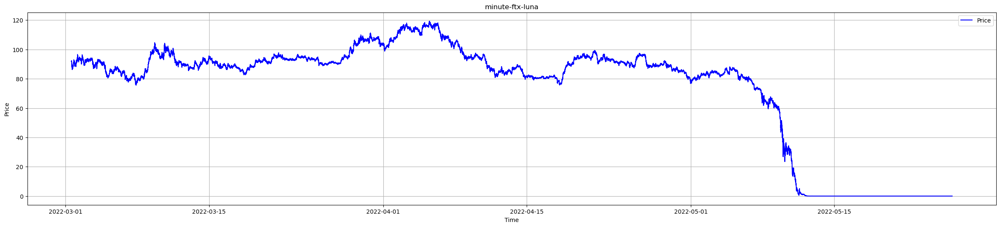

Index(['time', 'price'], dtype='object')
else


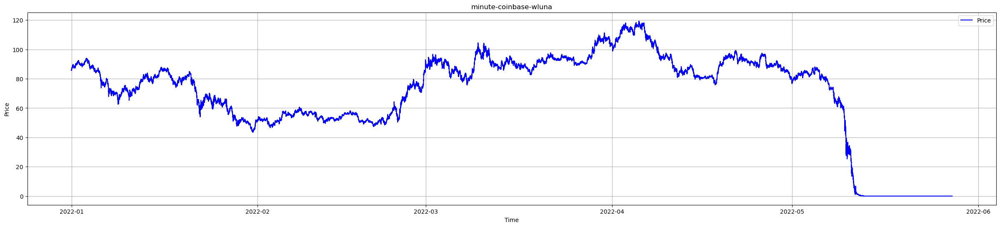

In [73]:
plot_stablecoin_prices("minute-kraken-luna", "minute-kraken-luna", dataframes)
plot_stablecoin_prices("minute-ftx-luna", "minute-ftx-luna", dataframes)
plot_stablecoin_prices("minute-coinbase-wluna", "minute-coinbase-wluna", dataframes)

Index(['time', 'price'], dtype='object')
else


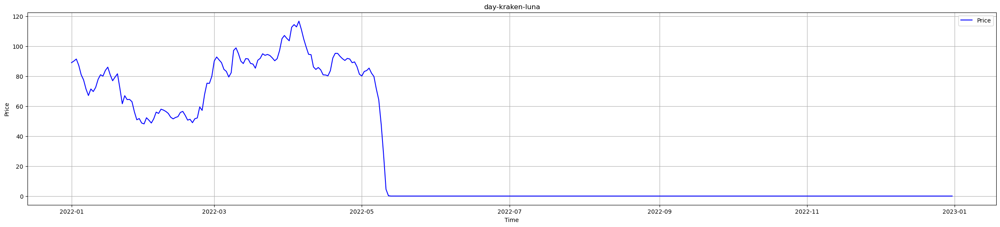

Index(['time', 'price'], dtype='object')
else


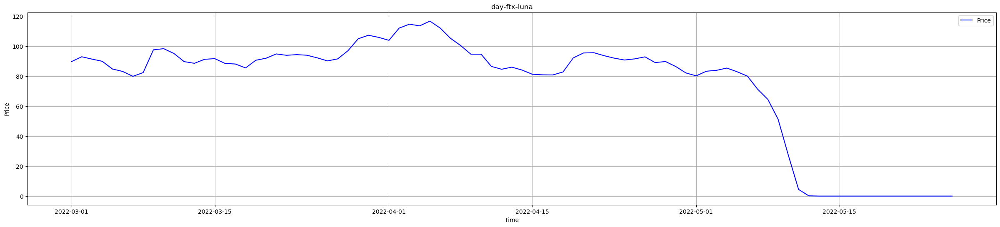

Index(['time', 'price'], dtype='object')
else


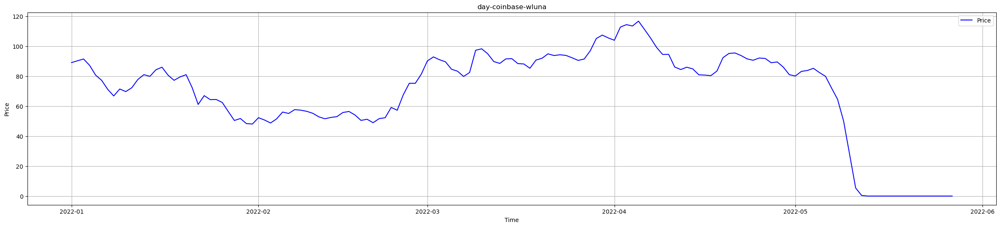

In [72]:
plot_stablecoin_prices("day-kraken-luna", "day-kraken-luna", dataframes)
plot_stablecoin_prices("day-ftx-luna", "day-ftx-luna", dataframes)
plot_stablecoin_prices("day-coinbase-wluna", "day-coinbase-wluna", dataframes)

In [8]:
# Pour "hour"
dataframes["hour-ftx-luna"] = dataframes["hour-ftx-luna"][dataframes["hour-ftx-luna"]["time"] < "2022-06-01"]
dataframes["hour-kraken-luna"] = dataframes["hour-kraken-luna"][dataframes["hour-kraken-luna"]["time"] < "2022-06-01"]
dataframes["hour-coinbase-wluna"] = dataframes["hour-coinbase-wluna"][dataframes["hour-coinbase-wluna"]["time"] < "2022-06-01"]

# Pour "day"
dataframes["day-ftx-luna"] = dataframes["day-ftx-luna"][dataframes["day-ftx-luna"]["time"] < "2022-06-01"]
dataframes["day-kraken-luna"] = dataframes["day-kraken-luna"][dataframes["day-kraken-luna"]["time"] < "2022-06-01"]
dataframes["day-coinbase-wluna"] = dataframes["day-coinbase-wluna"][dataframes["day-coinbase-wluna"]["time"] < "2022-06-01"]

# Pour "minute"
dataframes["minute-ftx-luna"] = dataframes["minute-ftx-luna"][dataframes["minute-ftx-luna"]["time"] < "2022-06-01"]
dataframes["minute-kraken-luna"] = dataframes["minute-kraken-luna"][dataframes["minute-kraken-luna"]["time"] < "2022-06-01"]
dataframes["minute-coinbase-wluna"] = dataframes["minute-coinbase-wluna"][dataframes["minute-coinbase-wluna"]["time"] < "2022-06-01"]


In [75]:
print(len(dataframes["hour-ftx-luna"]))

2063


In [13]:
dataframes["hour-ftx-luna"]["price"]

0          90.301
1       87.391948
2       87.644531
3       88.765505
4        90.14381
          ...    
2058     0.000149
2059     0.000154
2060     0.000159
2061     0.000151
2062     0.000149
Name: price, Length: 2063, dtype: Float64

In [11]:
dataframes["hour-ftx-luna"]

,time,price
0,2022-03-01 14:00:00+00:00,90.301
1,2022-03-01 15:00:00+00:00,87.391948
2,2022-03-01 16:00:00+00:00,87.644531
3,2022-03-01 17:00:00+00:00,88.765505
4,2022-03-01 18:00:00+00:00,90.14381
...,...,...
2058,2022-05-26 08:00:00+00:00,0.000149
2059,2022-05-26 09:00:00+00:00,0.000154
2060,2022-05-26 10:00:00+00:00,0.000159
2061,2022-05-26 11:00:00+00:00,0.000151


Index(['time', 'price'], dtype='object')
else


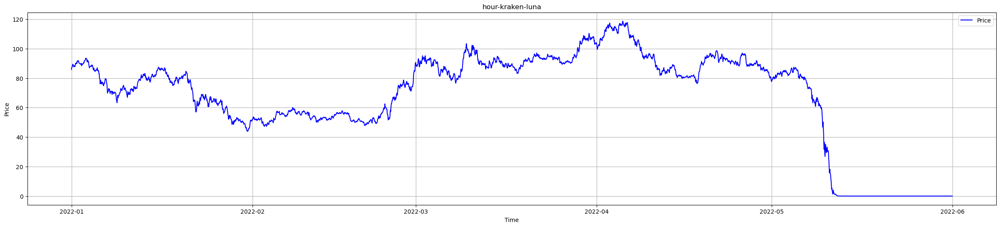

Index(['time', 'price'], dtype='object')
else


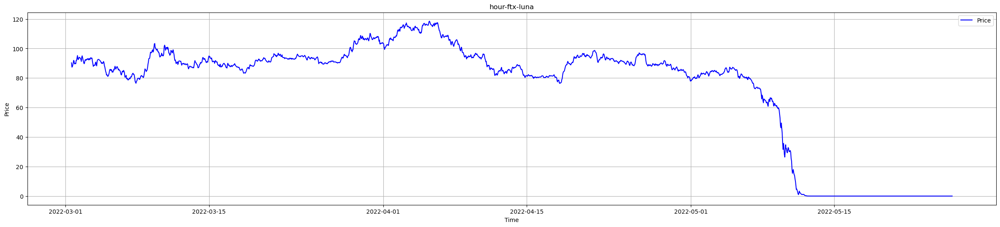

Index(['time', 'price'], dtype='object')
else


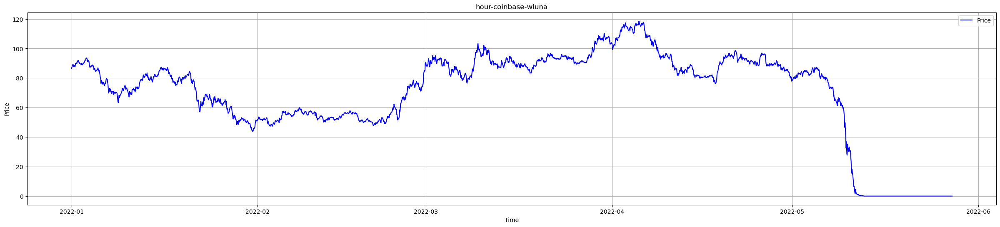

In [76]:
plot_stablecoin_prices("hour-kraken-luna", "hour-kraken-luna", dataframes)
plot_stablecoin_prices("hour-ftx-luna", "hour-ftx-luna", dataframes)
plot_stablecoin_prices("hour-coinbase-wluna", "hour-coinbase-wluna", dataframes)



In [23]:
def plot_stablecoin_prices_multi(stablecoins, title, dataframes):
    """
    Trace les prix de plusieurs stablecoins sur le même graphique.
    """
    
    plt.figure(figsize=(32, 6))
    for stablecoin in stablecoins:
        if stablecoin in dataframes:
            df = dataframes[stablecoin]
            plt.plot(df['time'], df['price'], label=stablecoin)

    plt.xlabel('Time')
    plt.ylabel('Price')
    plt.title(title)
    plt.legend()
    plt.grid(True)
    plt.show()


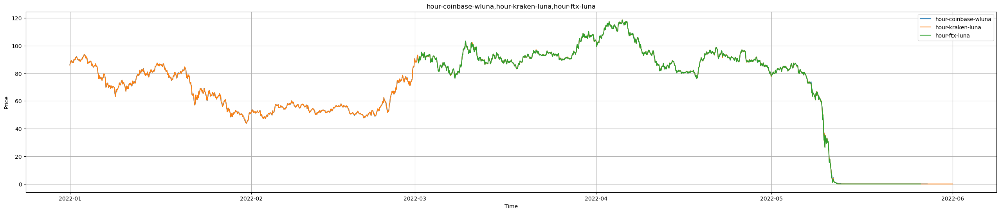

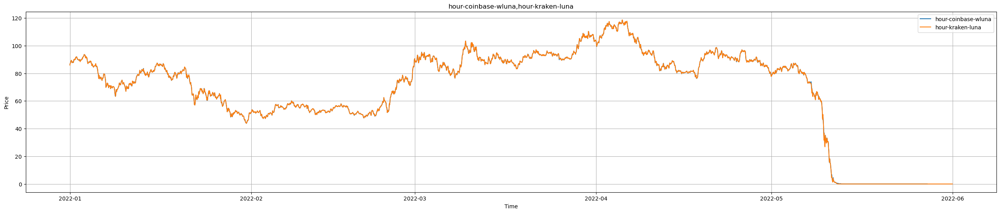

In [29]:
plot_stablecoin_prices_multi(["hour-coinbase-wluna","hour-kraken-luna","hour-ftx-luna"], "hour-coinbase-wluna,hour-kraken-luna,hour-ftx-luna", dataframes)
plot_stablecoin_prices_multi(["hour-coinbase-wluna","hour-kraken-luna"], "hour-coinbase-wluna,hour-kraken-luna", dataframes)


# Filtre de Kalman

In [16]:
import numpy as np
import plotly.graph_objects as go

def kalman_filter_plotly(stablecoin, dataframes,
                         F=1.0, H=1.0,
                         Q=1e-5, R=1e-3,
                         x0=None, P0=1.0):
    """
    Applique un filtre de Kalman 1D sur une série d'observations,
    puis trace le résultat avec Plotly.

    Paramètres
    ----------
    stablecoin : str
        Clé d'accès dans 'dataframes' pour sélectionner le DataFrame.
    dataframes : dict
        Dictionnaire contenant les DataFrame de différents stablecoins.
        dataframes[stablecoin] doit contenir au moins les colonnes "time" et "price".
    F : float
        Facteur de transition d'état (x_n = F * x_{n-1} + w_n).
    H : float
        Facteur d'observation (z_n = H * x_n + v_n).
    Q : float
        Variance du bruit de processus (w_n).
    R : float
        Variance du bruit d'observation (v_n).
    x0 : float ou None
        Estimation initiale de l'état. Si None, on prend la première observation comme point de départ.
    P0 : float
        Variance initiale associée à x0.

    Retour
    ------
    fig : plotly.graph_objects.Figure
        La figure Plotly générée (peut être affichée via fig.show()).
    x_est : ndarray
        Les estimations filtrées (posteriori) pour chaque pas de temps.
    P_est : ndarray
        Les variances a posteriori pour chaque pas de temps.
    """

    df = dataframes[stablecoin].copy()
    observations = df["price"].values
    times = df["time"].values
    n = len(df)

    # Allocation
    x_est = np.zeros(n)
    P_est = np.zeros(n)

    # Initialisation
    if x0 is None:
        x_est[0] = observations[0]
    else:
        x_est[0] = x0
    P_est[0] = P0

    # Filtre de Kalman
    for k in range(1, n):
        # PREDICTION
        x_pred = F * x_est[k-1]
        P_pred = F * P_est[k-1] * F + Q

        # MISE A JOUR
        y_k = observations[k] - H * x_pred   # innovation
        S_k = H * P_pred * H + R            # variance de l'innovation
        K_k = (P_pred * H) / S_k            # gain de Kalman
        x_est[k] = x_pred + K_k * y_k
        P_est[k] = (1 - K_k * H) * P_pred

    # On construit la figure Plotly
    fig = go.Figure()

    # Tracé des observations (points)
    fig.add_trace(go.Scatter(
        x=times,
        y=observations,
        mode='markers',
        name='Observations (bruitées)',
        marker=dict(color='red', size=4),
    ))

    # Tracé des estimations filtrées (ligne)
    fig.add_trace(go.Scatter(
        x=times,
        y=x_est,
        mode='lines',
        name='Filtre de Kalman',
        line=dict(color='blue')
    ))

    # Mise en forme
    fig.update_layout(
        title=f"Filtre de Kalman 1D sur {stablecoin} (Q={Q}, R={R})",
        xaxis_title="Time",
        yaxis_title="Price",
        template="plotly_white",
        legend=dict(x=0, y=1),
        width=1500,   # largeur en pixels
        height=600
    )
    

    return fig, x_est, P_est


In [17]:
fig, x_est, P_est = kalman_filter_plotly("hour-kraken-luna", dataframes, Q=1e-5, R=1e-3)
fig.show()


In [10]:
pip install ipywidgets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 19.5 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [19]:
import ipywidgets as widgets
from ipywidgets import interact

# On définit ici 4 valeurs possibles pour Q et R.
Q_options = [1e-8, 1e-7,1e-6,1e-5,1e-4,1e-3, 1e-2, 1e-1]
R_options = [1e-8, 1e-7,1e-6,1e-5,1e-4,1e-3, 1e-2, 1e-1]

@interact(
    Q=widgets.SelectionSlider(options=Q_options, value=1e-5, description='Q'),
    R=widgets.SelectionSlider(options=R_options, value=1e-3, description='R')
)
def interactive_kalman(Q, R):
    fig, x_est, P_est = kalman_filter_plotly("hour-kraken-luna", dataframes, Q=Q, R=R)
    fig.show()


interactive(children=(SelectionSlider(description='Q', index=3, options=(1e-08, 1e-07, 1e-06, 1e-05, 0.0001, 0…

In [47]:
aggreg("usdc","binance","hour")
aggreg("usdc","binance","minute")
aggreg("usdc","binance","day")
aggreg("usdc","kraken","hour")
aggreg("usdc","kraken","minute")
aggreg("usdc","kraken","day")




/tmp/ipykernel_4224/2598949796.py:13: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

/tmp/ipykernel_4224/2598949796.py:13: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.

/tmp/ipykernel_4224/2598949796.py:13: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

/tmp/ipykernel_4224/2598949796.py:13: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.



Index(['time', 'price'], dtype='object')
else


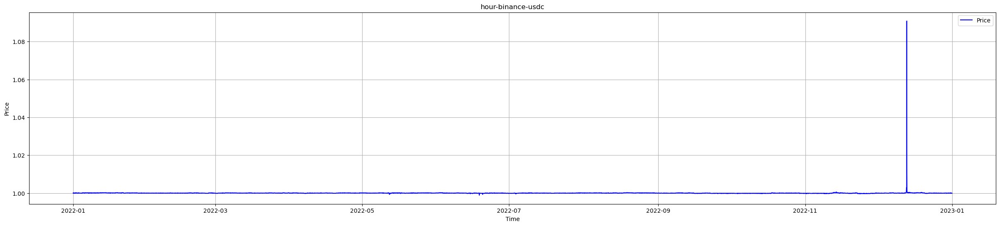

Index(['time', 'price'], dtype='object')
else


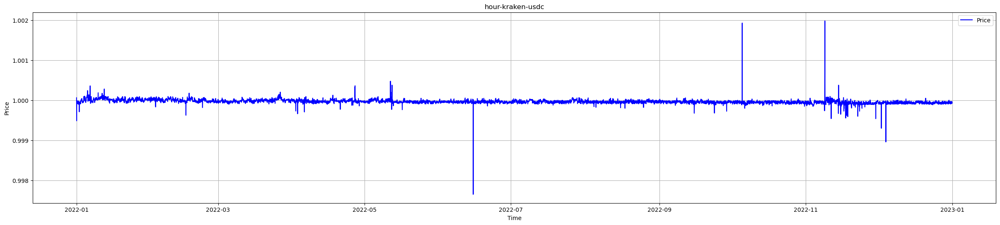

In [10]:
plot_stablecoin_prices("hour-binance-usdc", "hour-binance-usdc", dataframes)
plot_stablecoin_prices("hour-kraken-usdc", "hour-kraken-usdc", dataframes)


In [11]:
def remove_outliers(df, columns):
    """
    Remove outliers from the specified columns of a DataFrame.
    Outliers are defined as values that are more than 3 standard deviations away from the mean.
    Prints the number of outliers removed for each column.
    """
    for column in columns:
        if column in df.columns:
            # Calcul des bornes
            mean = df[column].mean()
            std = df[column].std()
            lower_bound = mean - 3 * std
            upper_bound = mean + 3 * std
            
            # Calcul du nombre de valeurs initiales
            initial_count = len(df)
            
            # Filtrage des valeurs dans les bornes
            df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
            
            # Nombre de valeurs supprimées
            final_count = len(df)
            print(f"{column}: {(initial_count - final_count)/initial_count} %outliers removed")
            
    return df


In [16]:
dataframes["new-hour-binance-usdc"]= remove_outliers(dataframes["hour-binance-usdc"],["price"])
dataframes["new-hour-kraken-usdc"]= remove_outliers(dataframes["hour-kraken-usdc"],["price"])
dataframes["new-day-binance-usdc"]= remove_outliers(dataframes["day-binance-usdc"],["price"])
dataframes["new-day-kraken-usdc"]= remove_outliers(dataframes["day-kraken-usdc"],["price"])
dataframes["new-minute-binance-usdc"]= remove_outliers(dataframes["minute-binance-usdc"],["price"])
dataframes["new-minute-kraken-usdc"]= remove_outliers(dataframes["minute-kraken-usdc"],["price"])

price: 0.0002295684113865932 %outliers removed
price: 0.005253540429419826 %outliers removed
price: 0.0027397260273972603 %outliers removed
price: 0.021917808219178082 %outliers removed
price: 2.8890461814032097e-05 %outliers removed
price: 0.0025597367127952555 %outliers removed


Index(['time', 'price'], dtype='object')
else


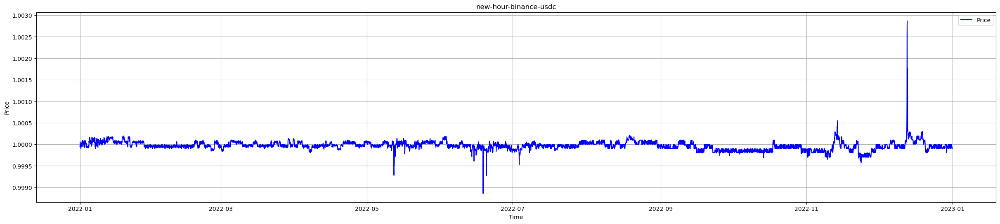

Index(['time', 'price'], dtype='object')
else


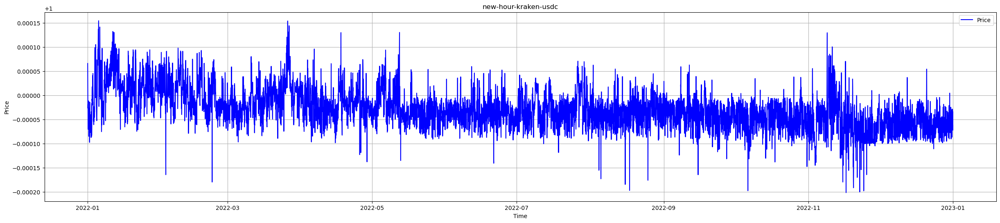

Index(['time', 'price'], dtype='object')
else


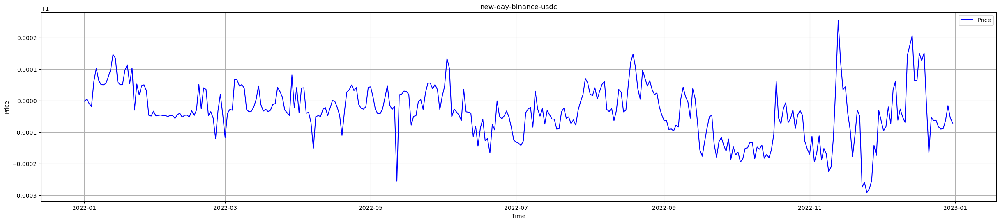

Index(['time', 'price'], dtype='object')
else


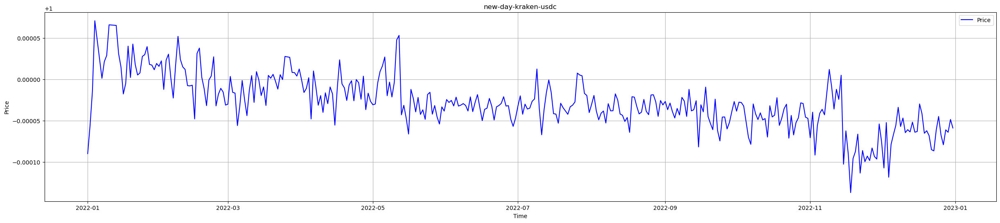

Index(['time', 'price'], dtype='object')
else


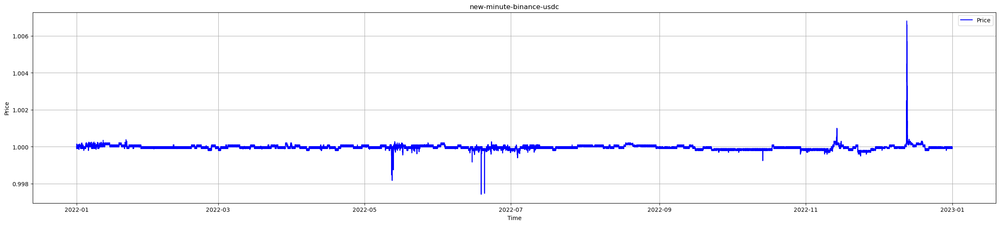

Index(['time', 'price'], dtype='object')
else


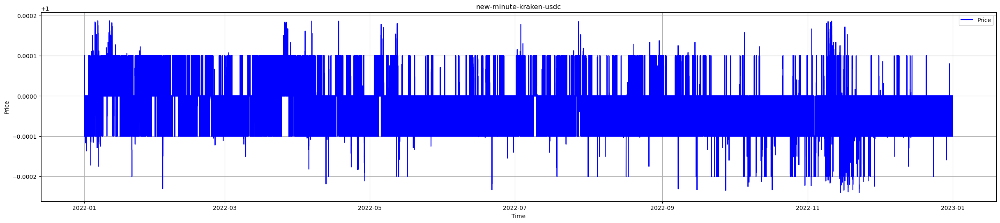

In [17]:
plot_stablecoin_prices("new-hour-binance-usdc", "new-hour-binance-usdc", dataframes)
plot_stablecoin_prices("new-hour-kraken-usdc", "new-hour-kraken-usdc", dataframes)
plot_stablecoin_prices("new-day-binance-usdc", "new-day-binance-usdc", dataframes)
plot_stablecoin_prices("new-day-kraken-usdc", "new-day-kraken-usdc", dataframes)
plot_stablecoin_prices("new-minute-binance-usdc", "new-minute-binance-usdc", dataframes)
plot_stablecoin_prices("new-minute-kraken-usdc", "new-minute-kraken-usdc", dataframes)

In [19]:
dataframes["new-new-hour-binance-usdc"]=remove_outliers(dataframes["new-hour-binance-usdc"],["price"])

price: 0.004477611940298508 %outliers removed


Index(['time', 'price'], dtype='object')
else


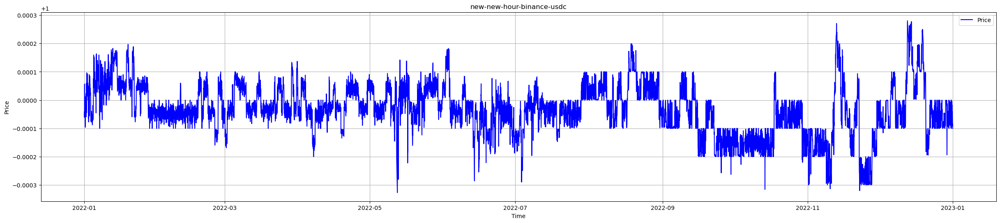

In [20]:
plot_stablecoin_prices("new-new-hour-binance-usdc", "new-new-hour-binance-usdc", dataframes)

/tmp/ipykernel_4224/1795854171.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["time"] = pd.to_datetime(df["time"], utc=True)


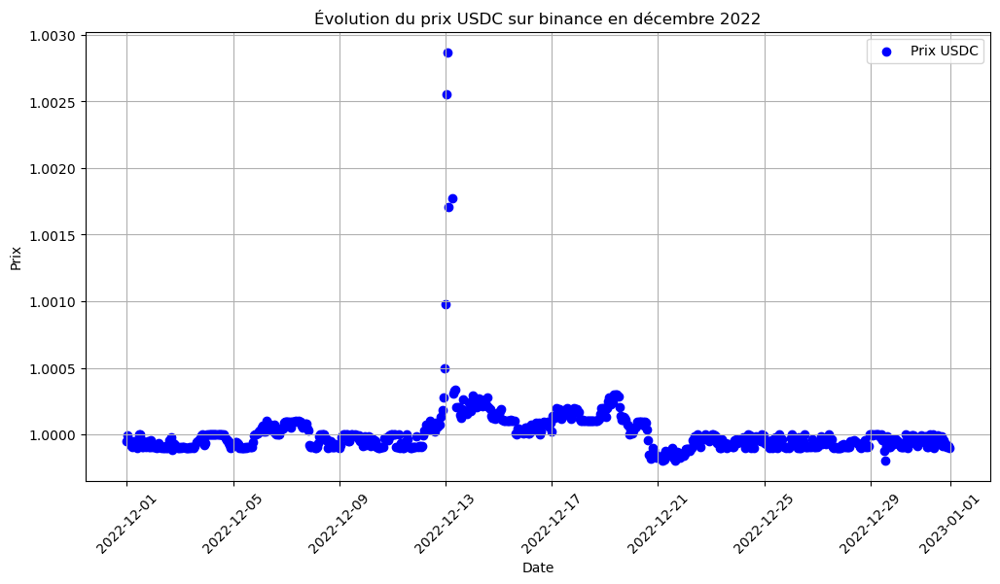

In [26]:
import matplotlib.pyplot as plt

# Charger les données
df = dataframes["new-hour-binance-usdc"]  # Adapter en fonction du contexte où le DataFrame est stocké

# S'assurer que la colonne 'time' est bien au format datetime
df["time"] = pd.to_datetime(df["time"], utc=True)

# Filtrer les données pour le mois de décembre 2022
df_december = df[(df["time"] >= "2022-12-01") & (df["time"] < "2023-01-01")]

# Tracer le graphique
plt.figure(figsize=(12, 6))
plt.scatter(df_december["time"], df_december["price"], label="Prix USDC", color="blue")
plt.xlabel("Date")
plt.ylabel("Prix")
plt.title("Évolution du prix USDC sur binance en décembre 2022")
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()


/tmp/ipykernel_4224/2855940317.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["time"] = pd.to_datetime(df["time"], utc=True)


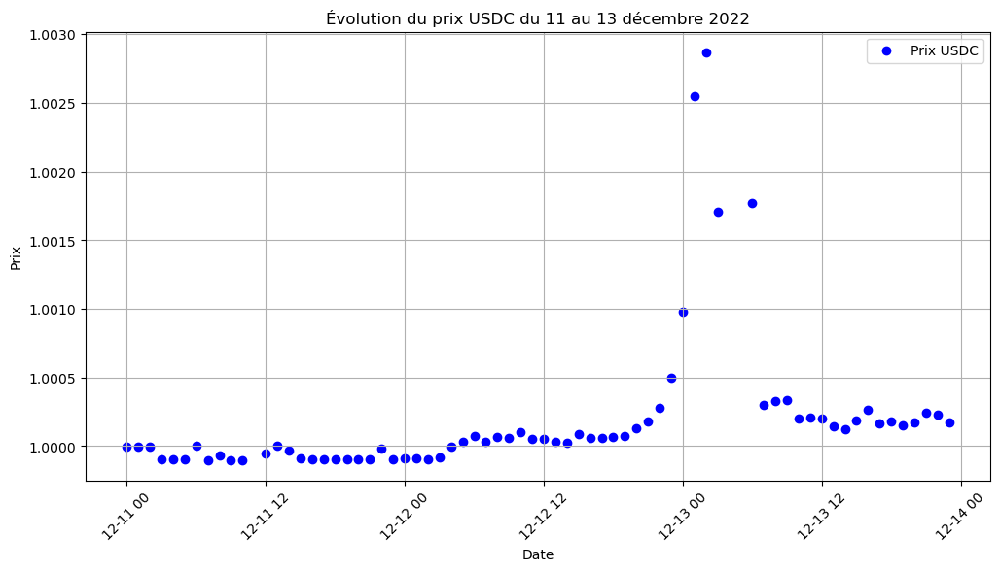

In [25]:
import pandas as pd
import matplotlib.pyplot as plt

# Charger les données
df = dataframes["new-hour-binance-usdc"]  # Adapter en fonction du contexte

# S'assurer que la colonne 'time' est bien au format datetime
df["time"] = pd.to_datetime(df["time"], utc=True)

# Filtrer les données pour les journées 11, 12 et 13 décembre 2022
df_dec_selected = df[(df["time"] >= "2022-12-11") & (df["time"] < "2022-12-14")]

# Tracer le graphique
plt.figure(figsize=(12, 6))
plt.scatter(df_dec_selected["time"], df_dec_selected["price"], label="Prix USDC", color="blue")
plt.xlabel("Date")
plt.ylabel("Prix")
plt.title("Évolution du prix USDC du 11 au 13 décembre 2022")
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()


## À la mi-décembre 2022, l’USDD s’est écarté de la parité à 1 dollar, et Justin Sun de Tron a déclaré que l’équipe avait déployé davantage de capital. L’USDD a connu des fluctuations de valeur depuis le 11 décembre 2022, et a atteint un minimum de 0,971 $ le 13 décembre 2022, selon les données de coingecko.com. La semaine dernière, un cas similaire s’est produit lorsque le prix de l’USDD a plongé à 0,972 $ par unité le 6 janvier 2023. Les graphiques montrent que l’action de l’USDD quatre jours plus tard, le mardi 10 janvier 2023, indique que le stablecoin a glissé jusqu’à 0,977 $ par unité au cours des dernières 24 heures.

#### L'USDD (Decentralized USD) est une stablecoin algorithmique lancée en 2022 par Justin Sun, le fondateur de la DAO Tron. Il fonctionne sur plusieurs réseaux de blockchain, notamment Ethereum, Tron et BNB Chain, et est indexé sur la valeur du dollar américain dans un rapport de 1:1. L'USDD est surcollatéralisé, soutenu par un ensemble diversifié d'actifs numériques tels que TRX, BTC et USDC, ce qui garantit sa stabilité et sa valeur. Il est conçu pour maintenir un taux de change fixe par rapport au dollar américain, ce qui en fait une réserve de valeur fiable au sein de l'écosystème décentralisé et des applications DeFi.

## Conclusion : on peut dire que c'est un vrai outlier 

/tmp/ipykernel_4224/2751458216.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["time"] = pd.to_datetime(df["time"], utc=True)


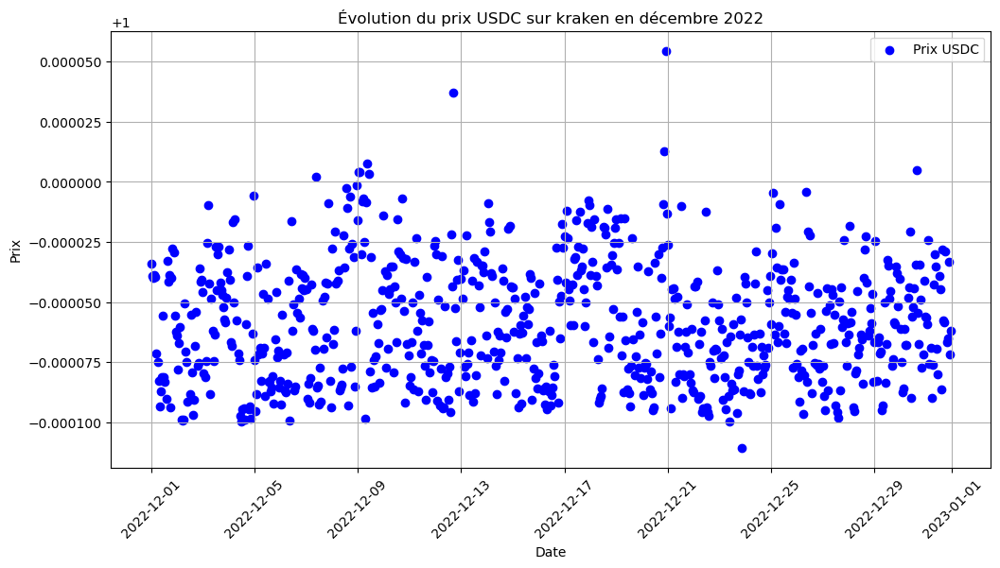

In [27]:
import matplotlib.pyplot as plt

# Charger les données
df = dataframes["new-hour-kraken-usdc"]  # Adapter en fonction du contexte où le DataFrame est stocké

# S'assurer que la colonne 'time' est bien au format datetime
df["time"] = pd.to_datetime(df["time"], utc=True)

# Filtrer les données pour le mois de décembre 2022
df_december = df[(df["time"] >= "2022-12-01") & (df["time"] < "2023-01-01")]

# Tracer le graphique
plt.figure(figsize=(12, 6))
plt.scatter(df_december["time"], df_december["price"], label="Prix USDC", color="blue")
plt.xlabel("Date")
plt.ylabel("Prix")
plt.title("Évolution du prix USDC sur kraken en décembre 2022")
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()


# En 2022, l'USDC n'a pas connu de dépeg notable. Cependant, en mars 2023, lors de l'effondrement de la Silicon Valley Bank, l'USDC a temporairement perdu sa parité avec le dollar américain, son prix tombant à 0,87 $. ​

# En 2022, le stablecoin Tether (USDT) a subi un dépeg notable en mai, lorsque son prix est tombé à 0,95 $, s'écartant ainsi de sa parité habituelle avec le dollar américain. Cette déviation a été attribuée à une combinaison de facteurs, notamment une volatilité accrue des marchés financiers, des attaques spéculatives et des problèmes de liquidité entravant les transactions des traders. ​


#En ce qui concerne le DAI, stablecoin décentralisé émis par MakerDAO, aucune information spécifique n'indique un dépeg significatif en 2022. Cependant, en mars 2023, le DAI a temporairement perdu sa parité avec le dollar américain, son prix tombant à 0,89 $. Cette déviation a été causée par la chute de l'USDC, qui constitue une part importante des réserves du DAI. Pour atténuer ce risque, MakerDAO a voté en faveur d'une augmentation de ses réserves en bons du Trésor américain, passant de 500 millions à 1,25 milliard de dollars, afin de diversifier les garanties soutenant le DAI.

/tmp/ipykernel_4224/3476214457.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["time"] = pd.to_datetime(df["time"], utc=True)


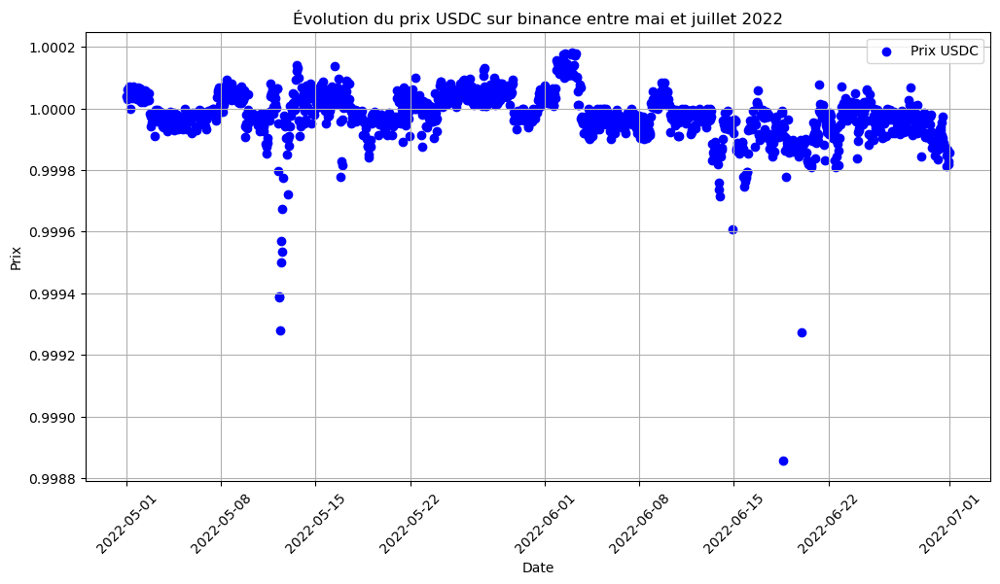

In [30]:
import matplotlib.pyplot as plt

# Charger les données
df = dataframes["new-hour-binance-usdc"]  # Adapter en fonction du contexte où le DataFrame est stocké

# S'assurer que la colonne 'time' est bien au format datetime
df["time"] = pd.to_datetime(df["time"], utc=True)

# Filtrer les données pour le mois de décembre 2022
df_december = df[(df["time"] >= "2022-05-01") & (df["time"] < "2022-07-01")]

# Tracer le graphique
plt.figure(figsize=(12, 6))
plt.scatter(df_december["time"], df_december["price"], label="Prix USDC", color="blue")
plt.xlabel("Date")
plt.ylabel("Prix")
plt.title("Évolution du prix USDC sur binance entre mai et juillet 2022")
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()


# Etant donné que pendant l'année 2022, il n'y pas eu de depeg pour l'usdc et le dai, je m'interesse au usdt

In [21]:
aggreg("usdt", "binance", "hour")
aggreg("usdt", "binance", "minute")
aggreg("usdt", "binance", "day")
aggreg("usdt", "kraken", "hour")
aggreg("usdt", "kraken", "minute")
aggreg("usdt", "kraken", "day")
aggreg("usdt", "coinbase", "hour")
aggreg("usdt", "coinbase", "minute")
aggreg("usdt", "coinbase", "day")
aggreg("cusdt", "ftx", "hour")
aggreg("cusdt", "ftx", "minute")
aggreg("cusdt", "ftx", "day")


/tmp/ipykernel_38864/2598949796.py:13: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

/tmp/ipykernel_38864/2598949796.py:13: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.

/tmp/ipykernel_38864/2598949796.py:13: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

/tmp/ipykernel_38864/2598949796.py:13: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.

/tmp/ipykernel_38864/2598949796.py:13: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

/tmp/ipykernel_38864/2598949796.py:13: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.

/tmp/ipykernel_38864/2598949796.py:13: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

/tmp/ipykernel_38864/

Index(['time', 'price'], dtype='object')
else


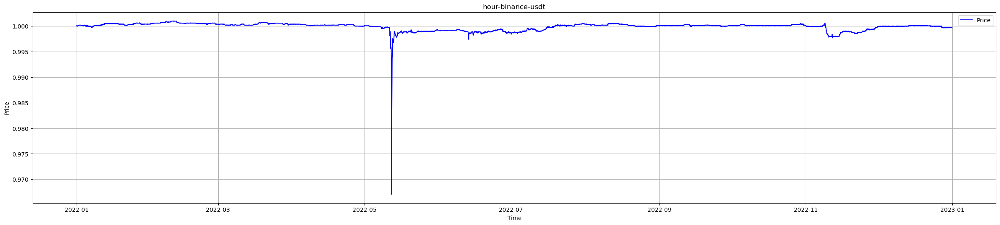

Index(['time', 'price'], dtype='object')
else


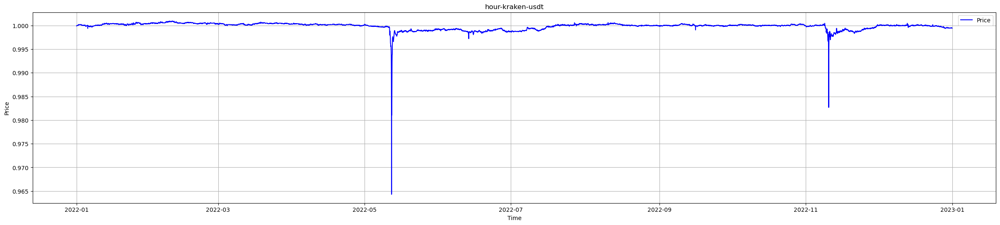

Index(['time', 'price'], dtype='object')
else


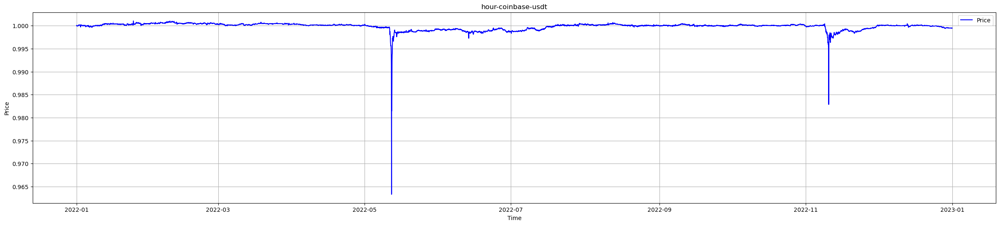

In [33]:
plot_stablecoin_prices("hour-binance-usdt", "hour-binance-usdt", dataframes)
plot_stablecoin_prices("hour-kraken-usdt", "hour-kraken-usdt", dataframes)
# plot_stablecoin_prices("hour-ftx-cusdt", "hour-ftx-cusdt", dataframes)
plot_stablecoin_prices("hour-coinbase-usdt", "hour-coinbase-usdt", dataframes)

In [ ]:
# dataframes["new-hour-binance-usdt"] = remove_outliers(dataframes["hour-binance-usdt"], ["price"])
# dataframes["new-hour-kraken-usdt"] = remove_outliers(dataframes["hour-kraken-usdt"], ["price"])
# dataframes["new-hour-coinbase-usdt"] = remove_outliers(dataframes["hour-coinbase-usdt"], ["price"])
# dataframes["new-hour-ftx-cusdt"] = remove_outliers(dataframes["hour-ftx-cusdt"], ["price"])

# dataframes["new-day-binance-usdt"] = remove_outliers(dataframes["day-binance-usdt"], ["price"])
# dataframes["new-day-kraken-usdt"] = remove_outliers(dataframes["day-kraken-usdt"], ["price"])
# dataframes["new-day-coinbase-usdt"] = remove_outliers(dataframes["day-coinbase-usdt"], ["price"])
# dataframes["new-day-ftx-cusdt"] = remove_outliers(dataframes["day-ftx-cusdt"], ["price"])

# dataframes["new-minute-binance-usdt"] = remove_outliers(dataframes["minute-binance-usdt"], ["price"])
# dataframes["new-minute-kraken-usdt"] = remove_outliers(dataframes["minute-kraken-usdt"], ["price"])
# dataframes["new-minute-coinbase-usdt"] = remove_outliers(dataframes["minute-coinbase-usdt"], ["price"])
# dataframes["new-minute-ftx-cusdt"] = remove_outliers(dataframes["minute-ftx-cusdt"], ["price"])


In [43]:
import ipywidgets as widgets
from ipywidgets import interact

# On définit ici 4 valeurs possibles pour Q et R.
Q_options = [1e-8, 1e-7,1e-6,1e-5,1e-4,1e-3, 1e-2, 1e-1]
R_options = [1e-8, 1e-7,1e-6,1e-5,1e-4,1e-3, 1e-2, 1e-1]

@interact(
    Q=widgets.SelectionSlider(options=Q_options, value=1e-5, description='Q'),
    R=widgets.SelectionSlider(options=R_options, value=1e-3, description='R')
)
def interactive_kalman(Q, R):
    fig, x_est, P_est = kalman_filter_plotly("hour-binance-usdt", dataframes, Q=Q, R=R)
    fig.show()


interactive(children=(SelectionSlider(description='Q', index=3, options=(1e-08, 1e-07, 1e-06, 1e-05, 0.0001, 0…

## Premier detecteur de depeg : Seuil basé sur l'écart-type 

In [23]:
import numpy as np
import plotly.graph_objects as go

def kalman_filter_depeg(stablecoin, dataframes, F=1.0, H=1.0, Q=1e-5, R=1e-3, x0=None, P0=1.0, peg=1.0, threshold=3):
    """
    Applique un filtre de Kalman 1D sur une série d'observations, détecte les dépegs
    et trace le résultat avec Plotly.
    
    stablecoin : str
        Clé d'accès dans 'dataframes' pour sélectionner le DataFrame.
    dataframes : dict
        Dictionnaire contenant les DataFrame de différents stablecoins.
        dataframes[stablecoin] doit contenir au moins les colonnes "time" et "price".
    F, H, Q, R, x0, P0 : float
        Paramètres du filtre de Kalman.
    peg : float
        Valeur de référence du peg (ex : 1 pour un stablecoin à 1$).
    threshold : float
        Multiplicateur de l'écart-type (ex : 3 pour 3σ).
    
    Retour
    ------
    fig : plotly.graph_objects.Figure
        La figure Plotly générée.
    x_est : ndarray
        Les estimations filtrées pour chaque pas de temps.
    P_est : ndarray
        Les variances a posteriori pour chaque pas de temps.
    detection : ndarray (bool)
        Tableau booléen indiquant si un dépeg est détecté.
    """
    df = dataframes[stablecoin].copy()
    observations = df["price"].values
    times = df["time"].values
    n = len(df)
    x_est = np.zeros(n)
    P_est = np.zeros(n)
    if x0 is None:
        x_est[0] = observations[0]
    else:
        x_est[0] = x0
    P_est[0] = P0
    for k in range(1, n):
        x_pred = F * x_est[k-1]
        P_pred = F * P_est[k-1] * F + Q
        y_k = observations[k] - H * x_pred
        S_k = H * P_pred * H + R
        K_k = (P_pred * H) / S_k
        x_est[k] = x_pred + K_k * y_k
        P_est[k] = (1 - K_k * H) * P_pred
    detection = np.abs(x_est - peg) > threshold * np.sqrt(P_est)
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=times, y=observations, mode='markers', name='Observations (bruitées)', marker=dict(color='red', size=4)))
    fig.add_trace(go.Scatter(x=times, y=x_est, mode='lines', name='Filtre de Kalman', line=dict(color='blue')))
    fig.add_trace(go.Scatter(x=times[detection], y=x_est[detection], mode='markers', name='Dépeg détecté', marker=dict(color='orange', size=10, symbol='x')))
    fig.update_layout(title=f"Filtre de Kalman 1D sur {stablecoin} (Q={Q}, R={R})", xaxis_title="Time", yaxis_title="Price", template="plotly_white", legend=dict(x=0, y=1), width=1500, height=600)
    return fig, x_est, P_est, detection


In [34]:
# Appel de la fonction kalman_filter_depeg (assure-toi que la fonction est déjà définie)
fig, x_est, P_est, detection = kalman_filter_depeg("hour-binance-usdt", dataframes, Q=1e-5, R=1e-3, peg=1.0, threshold=0.5)

# Affichage de la figure Plotly
fig.show()

##  Ajuster **Q** et **R**

- **Q (variance du bruit de processus)**  
  - Si **Q** est trop petit, le filtre « colle » trop au modèle et ne réagit pas assez aux changements soudains (la variance \(P_{\text{est}}\) reste faible).  
  - **Augmenter Q** rend le filtre plus réactif et donc l’incertitude \(P_{\text{est}}\) peut monter plus vite lors d’un écart, ce qui peut faciliter la détection.

- **R (variance du bruit d’observation)**  
  - Si **R** est trop grand, le filtre fait moins confiance aux observations et s’en écarte peu, d’où un plus faible \(|x_{\text{est}} - \text{peg}|\).  
  - **Diminuer R** fait plus coller l’estimation aux observations, et donc un écart ponctuel est plus facilement vu comme un « dépeg ».


## 1. Qu’est-ce que l’innovation ?

Dans un filtre de Kalman, **l’innovation** (ou résidu) représente la différence entre l’observation réelle et la prédiction de l’observation. 

À chaque itération \(k\) :
\[
y_k \;=\; z_k \;-\; H \, x_{\text{pred}},
\]
- \(z_k\) : l’observation au temps \(k\) (par exemple, un prix mesuré),
- \(x_{\text{pred}}\) : l’état prédit (par la dynamique du système),
- \(H\) : le coefficient ou la matrice d’observation.

Si l’innovation \(\lvert y_k\rvert\) devient anormalement grande (au regard de son écart-type), cela indique que l’observation s’écarte fortement de ce que prévoit le modèle, et peut donc révéler un « dépeg » ou une anomalie.


In [36]:
import numpy as np
import plotly.graph_objects as go

def kalman_filter_depeg_innovation(stablecoin, dataframes, F=1.0, H=1.0, Q=1e-5, R=1e-3,
                                   x0=None, P0=1.0, threshold=3):
    """
    Filtre de Kalman 1D sur 'stablecoin' puis détection de dépeg via l'innovation.

    Paramètres
    ----------
    stablecoin : str
        Clé pour accéder au DataFrame dans 'dataframes'.
    dataframes : dict
        Dictionnaire contenant les DataFrame. dataframes[stablecoin] doit avoir "time" et "price".
    F, H, Q, R, x0, P0 : float
        Paramètres du filtre de Kalman.
    threshold : float
        Multiplicateur d'écart-type pour la détection sur l'innovation.

    Retour
    ------
    fig : plotly.graph_objects.Figure
        Figure Plotly avec tracé du prix, estimation et points de détection.
    x_est : ndarray
        Estimations filtrées pour chaque pas de temps.
    P_est : ndarray
        Variances a posteriori pour chaque pas de temps.
    innovation : ndarray
        Valeurs de l'innovation y_k pour chaque pas de temps.
    detection : ndarray (bool)
        Tableau booléen indiquant si un dépeg est détecté (True) à l'instant k.
    """

    df = dataframes[stablecoin].copy()
    observations = df["price"].values
    times = df["time"].values
    n = len(df)

    # Allocation
    x_est = np.zeros(n)
    P_est = np.zeros(n)
    innovation = np.zeros(n)
    innovation_std = np.zeros(n)

    # Initialisation
    if x0 is None:
        x_est[0] = observations[0]
    else:
        x_est[0] = x0
    P_est[0] = P0

    # Boucle de Kalman
    for k in range(1, n):
        # 1) PREDICTION
        x_pred = F * x_est[k-1]
        P_pred = F * P_est[k-1] * F + Q

        # 2) CALCUL DE L'INNOVATION
        y_k = observations[k] - H * x_pred  # innovation
        S_k = H * P_pred * H + R           # variance de l'innovation
        K_k = (P_pred * H) / S_k

        # 3) MISE A JOUR DE L'ETAT
        x_est[k] = x_pred + K_k * y_k
        P_est[k] = (1 - K_k * H) * P_pred

        # On stocke l'innovation et son écart-type
        innovation[k] = y_k
        innovation_std[k] = np.sqrt(S_k)

    # Détection si |y_k| > threshold * sqrt(S_k)
    detection = np.abs(innovation) > threshold * innovation_std

    # Tracé Plotly
    fig = go.Figure()
    # 1) Observations
    fig.add_trace(go.Scatter(
        x=times,
        y=observations,
        mode='markers',
        name='Observations (bruitées)',
        marker=dict(color='red', size=4)
    ))
    # 2) Filtre de Kalman
    fig.add_trace(go.Scatter(
        x=times,
        y=x_est,
        mode='lines',
        name='Filtre de Kalman',
        line=dict(color='blue')
    ))
    # 3) Points de dépeg (où l'innovation dépasse le seuil)
    fig.add_trace(go.Scatter(
        x=times[detection],
        y=observations[detection],
        mode='markers',
        name='Dépeg détecté (via innovation)',
        marker=dict(color='orange', size=10, symbol='x')
    ))
    fig.update_layout(
        title=f"Filtre de Kalman (Surveillance de l'innovation) - threshold={threshold}",
        xaxis_title="Time",
        yaxis_title="Price",
        template="plotly_white",
        legend=dict(x=0, y=1),
        width=1000,
        height=500
    )
    return fig, x_est, P_est, innovation, detection


In [52]:
fig, x_est, P_est, innovation, detection = kalman_filter_depeg_innovation(
    stablecoin="hour-binance-usdt",
    dataframes=dataframes,
    Q=1e-5,
    R=1e-3,
    threshold=0.5
)
fig.show()


In [50]:
import numpy as np
import plotly.graph_objects as go

def kalman_filter_logprice(stablecoin, dataframes, Q=1e-5, R=1e-3, x0=None, P0=1.0):
    """
    Filtre de Kalman 1D sur le log-prix, puis restitution en prix normal.
    
    Paramètres
    ----------
    stablecoin : str
        Clé d'accès dans 'dataframes' pour sélectionner le DataFrame.
    dataframes : dict
        Dictionnaire contenant les DataFrame. dataframes[stablecoin] doit contenir
        au moins 'time' et 'price'.
    Q, R : float
        Variances du bruit de processus et d'observation, dans l'espace log.
    x0 : float ou None
        Estimation initiale du log-prix. Si None, on prend ln(price[0]).
    P0 : float
        Variance initiale associée à x0.
    
    Retour
    ------
    fig : plotly.graph_objects.Figure
        Figure Plotly avec le tracé du prix brut et de l'estimation filtrée (exponentiée).
    x_est : ndarray
        Estimations filtrées (log-prix) pour chaque pas de temps.
    P_est : ndarray
        Variances a posteriori (log-prix).
    """

    df = dataframes[stablecoin].copy()
    prices = df["price"].values
    times = df["time"].values
    n = len(df)

    # On transforme le prix en log-prix (en évitant d'éventuels 0)
    log_prices = np.log(prices + 1e-15)

    # Allocation
    x_est = np.zeros(n)
    P_est = np.zeros(n)

    # Initialisation
    if x0 is None:
        x_est[0] = log_prices[0]
    else:
        x_est[0] = x0
    P_est[0] = P0

    # Boucle du filtre de Kalman (modèle: x_n = x_{n-1} + w_n, z_n = x_n + v_n)
    for k in range(1, n):
        # PREDICTION
        x_pred = x_est[k-1]          # x_n|n-1
        P_pred = P_est[k-1] + Q      # P_n|n-1 (car F=1 en 1D)

        # MISE A JOUR
        y_k = log_prices[k] - x_pred # innovation
        S_k = P_pred + R             # variance de l'innovation (car H=1)
        K_k = P_pred / S_k           # gain de Kalman
        x_est[k] = x_pred + K_k * y_k
        P_est[k] = (1 - K_k) * P_pred

    # On exponentie x_est pour repasser dans l'espace "prix"
    price_est = np.exp(x_est)

    # Construction de la figure Plotly
    fig = go.Figure()
    # 1) Observations (prix brut)
    fig.add_trace(go.Scatter(
        x=times,
        y=prices,
        mode='markers',
        name='Observations (prix brut)',
        marker=dict(color='red', size=4)
    ))
    # 2) Filtre exponentié
    fig.add_trace(go.Scatter(
        x=times,
        y=price_est,
        mode='lines',
        name='Filtre de Kalman (exp)',
        line=dict(color='blue')
    ))
    fig.update_layout(
        title=f"Filtre de Kalman 1D sur log-price ({stablecoin}), Q={Q}, R={R}",
        xaxis_title="Time",
        yaxis_title="Price",
        template="plotly_white",
        legend=dict(x=0, y=1),
        width=900,
        height=500
    )
    return fig, x_est, P_est


In [51]:
fig, x_est, P_est, = kalman_filter_logprice(
    stablecoin="hour-binance-usdt",
    dataframes=dataframes,
    Q=1e-5,
    R=1e-3,
    
)
fig.show()


## Introduction à la méthode CUSUM

La méthode **CUSUM** (Cumulative Sum) est une technique de détection de ruptures qui consiste à cumuler les écarts par rapport à une valeur de référence attendue. L'idée principale est que de petites déviations, même si elles sont insignifiantes isolément, peuvent s'accumuler au fil du temps et indiquer un changement de régime dans le processus observé.

### Principe
- **Écart** : À chaque instant, on calcule la différence entre la valeur observée et la valeur attendue (par exemple, le peg d'un stablecoin, souvent égal à 1).
- **Cumul** : Ces écarts sont additionnés cumulativement. On crée deux séries :
  - Une somme cumulative positive, qui s'accumule lorsque l'écart est positif.
  - Une somme cumulative négative, qui s'accumule lorsque l'écart est négatif.
- **Détection** : Si l'une de ces sommes dépasse un seuil prédéfini, cela est interprété comme une rupture ou un changement significatif dans le comportement de la série.

### Application pour un Stablecoin
Dans le cas d'un stablecoin, dont la valeur est censée rester proche de 1, on peut utiliser CUSUM pour détecter les dépegs :
- On surveille l'écart entre l'estimation filtrée (par exemple, obtenue via un filtre de Kalman) et le peg.
- Si la somme cumulée des écarts (positive ou négative) dépasse un certain seuil, cela peut indiquer qu'une rupture est en cours (par exemple, un dépeg).

Cette approche permet ainsi d'alerter sur des changements de régime persistants qui pourraient ne pas être détectés par des variations ponctuelles.


In [67]:
import numpy as np

def cusum(x, mu=0.0, h=1.0):
    """
    Détection de rupture CUSUM univarié.
    x : série de données (numpy array).
    mu : drift de référence (moyenne attendue).
    h : seuil d'alarme.
    Retourne : (g_plus, g_minus, alarm_plus, alarm_minus)
    """
    n = len(x)
    g_plus = np.zeros(n)
    g_minus = np.zeros(n)
    alarm_plus = []
    alarm_minus = []
    
    for k in range(1, n):
        # CUSUM +
        g_plus[k] = max(0, g_plus[k-1] + (x[k] - mu))
        if g_plus[k] > h:
            alarm_plus.append(k)
            g_plus[k] = 0 #pour détecter plusieurs ruptures successives

        # CUSUM -
        g_minus[k] = min(0, g_minus[k-1] + (x[k] - mu))
        if abs(g_minus[k]) > h:
            alarm_minus.append(k)
            g_minus[k] = 0
        g_minus[k] = 0

    return g_plus, g_minus, alarm_plus, alarm_minus


In [68]:
import plotly.graph_objects as go

def kalman_filter_cusum(stablecoin, dataframes,
                        F=1.0, H=1.0, Q=1e-5, R=1e-3,
                        x0=None, P0=1.0,
                        peg=1.0, cusum_mu=0.0, cusum_h=0.01):
    """
    Applique un filtre de Kalman 1D, puis détecte des ruptures via CUSUM
    sur l'écart (x_est - peg).

    Paramètres
    ----------
    stablecoin : str
        Clé d'accès dans 'dataframes' pour sélectionner le DataFrame.
    dataframes : dict
        Doit contenir df[stablecoin] avec colonnes "time" et "price".
    F, H, Q, R, x0, P0 : float
        Paramètres du filtre de Kalman.
    peg : float
        Valeur de référence du peg.
    cusum_mu : float
        Drift de référence pour CUSUM (typiquement 0 si on veut détecter tout écart).
    cusum_h : float
        Seuil de détection CUSUM.

    Retour
    ------
    fig : go.Figure
        Figure Plotly avec l'estimation et les ruptures détectées.
    x_est : ndarray
        Estimation filtrée à chaque pas de temps.
    P_est : ndarray
        Variances a posteriori.
    alarms_plus : list
        Indices où CUSUM détecte une rupture vers le haut.
    alarms_minus : list
        Indices où CUSUM détecte une rupture vers le bas.
    """
    # 1) Récupération des données
    df = dataframes[stablecoin].copy()
    observations = df["price"].values
    times = df["time"].values
    n = len(df)

    # 2) Allocation
    x_est = np.zeros(n)
    P_est = np.zeros(n)

    # 3) Initialisation
    if x0 is None:
        x_est[0] = observations[0]
    else:
        x_est[0] = x0
    P_est[0] = P0

    # 4) Boucle du filtre de Kalman
    for k in range(1, n):
        # PREDICTION
        x_pred = F * x_est[k-1]
        P_pred = F * P_est[k-1] * F + Q

        # MISE A JOUR
        y_k = observations[k] - H * x_pred
        S_k = H * P_pred * H + R
        K_k = (P_pred * H) / S_k
        x_est[k] = x_pred + K_k * y_k
        P_est[k] = (1 - K_k * H) * P_pred

    # 5) On calcule l'écart par rapport au peg
    x_diff = x_est - peg

    # 6) Application du CUSUM
    g_plus, g_minus, alarms_plus, alarms_minus = cusum(x_diff, mu=cusum_mu, h=cusum_h)

    # 7) Construction de la figure Plotly
    fig = go.Figure()

    # a) Observations
    fig.add_trace(go.Scatter(
        x=times, y=observations,
        mode='markers', name='Observations',
        marker=dict(color='red', size=4)
    ))

    # b) Estimation filtrée
    fig.add_trace(go.Scatter(
        x=times, y=x_est,
        mode='lines', name='Filtre de Kalman',
        line=dict(color='blue')
    ))

    # c) Points de rupture "plus"
    fig.add_trace(go.Scatter(
        x=times[alarms_plus],
        y=x_est[alarms_plus],
        mode='markers',
        name='Rupture (CUSUM +)',
        marker=dict(color='orange', size=10, symbol='x')
    ))

    # d) Points de rupture "minus"
    fig.add_trace(go.Scatter(
        x=times[alarms_minus],
        y=x_est[alarms_minus],
        mode='markers',
        name='Rupture (CUSUM -)',
        marker=dict(color='green', size=10, symbol='x')
    ))

    # Mise en forme
    fig.update_layout(
        title=f"Kalman + CUSUM sur {stablecoin} (Q={Q}, R={R}, h={cusum_h})",
        xaxis_title="Time",
        yaxis_title="Price",
        template="plotly_white",
        legend=dict(x=0, y=1),
        width=1200,
        height=600
    )

    return fig, x_est, P_est, alarms_plus, alarms_minus


In [69]:
fig, x_est, P_est, alarms_plus, alarms_minus = kalman_filter_cusum(
    stablecoin="hour-binance-usdt",
    dataframes=dataframes,
    F=1.0, H=1.0,
    Q=1e-5, R=1e-3,
    peg=1.0,
    cusum_mu=0.0,
    cusum_h=1
)
fig.show()

print("Indices de rupture (vers le haut) :", alarms_plus)
print("Indices de rupture (vers le bas) :", alarms_minus)



Indices de rupture (vers le haut) : []
Indices de rupture (vers le bas) : []


In [70]:

import ipywidgets as widgets
from ipywidgets import interact

# On définit ici 4 valeurs possibles pour Q et R.
cusum_h_options = [0.1, 0.3, 0.5,0.7,0.9,1,2,3]

@interact(
    cusum_h=widgets.SelectionSlider(options=cusum_h_options, value=0.5, description='cusum_h'),
   
)

def interactive_CUSUM(cusum_h):
    fig, x_est, P_est, alarms_plus, alarms_minus = kalman_filter_cusum(
    stablecoin="hour-binance-usdt",
    dataframes=dataframes,
    F=1.0, H=1.0,
    Q=1e-5, R=1e-3,
    peg=1.0,
    cusum_mu=0.0,
    cusum_h=cusum_h
    )   
    fig.show()





interactive(children=(SelectionSlider(description='cusum_h', index=2, options=(0.1, 0.3, 0.5, 0.7, 0.9, 1, 2, …